In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import os
import utils


features_1 = [
    'sx_x',
    'sx_y',
    'sx_z',
    'sx_roll',
    'sx_pitch',
    'sx_yaw',
    'sx_thumb',
    'sx_forefinger',
    'sx_middle_finger',
    'sx_ring_finger',
    'sx_little_finger',
    'dx_x',
    'dx_y',
    'dx_z',
    'dx_roll',
    'dx_pitch',
    'dx_yaw',
    'dx_thumb',
    'dx_forefinger',
    'dx_middle_finger',
    'dx_ring_finger',
    'dx_little_finger'
    ]


In [2]:
path = "./tctodd/"
dirs = os.listdir(path=path)
weeks = sorted([i for i in dirs if i != ".DS_Store"])
filenames = sorted(os.listdir(path+weeks[1]))

data = []
labels = dict()
label_cnt = 0

for w in weeks:
    temp_path = path+w+"/"
    filenames = sorted(os.listdir(temp_path))
    for fn in filenames:
        label = fn.split('.')[0][:-2]
        
        if label not in labels:
            labels[label] = label_cnt
            label_cnt += 1
            
        data.append({'label':labels[label], 'time_series':pd.read_csv(temp_path+fn, header=None, sep='\t',).values})
        

In [3]:
df = pd.DataFrame(data, columns=['label', 'time_series'])

In [4]:
one = labels['hello'] # one-handed
two = labels['God'] #two-handed
spec_two = labels['where'] #specular two-handed

one_mask = df['label'] == one
two_mask = df['label'] == two
spec_two_mask = df['label'] == spec_two

one_data = df[one_mask].iloc[0]['time_series']
two_data = df[two_mask].iloc[0]['time_series']
spec_two_data = df[spec_two_mask].iloc[0]['time_series']

In [41]:
for i,v in zip(features_1,np.std(one_data, axis=0)):
    print(f"feature {i}, variance: {v}")

a = np.mean(one_data, axis=0)
a[:3] + a[11:14]

feature sx_x, variance: 0.011165156852368052
feature sx_y, variance: 0.00185070747089322
feature sx_z, variance: 0.0013716773996307033
feature sx_roll, variance: 0.0013970627926725892
feature sx_pitch, variance: 0.0028525606967453
feature sx_yaw, variance: 0.0009095776376583846
feature sx_thumb, variance: 0.021322331452090545
feature sx_forefinger, variance: 0.0
feature sx_middle_finger, variance: 0.0
feature sx_ring_finger, variance: 0.0
feature sx_little_finger, variance: 0.0
feature dx_x, variance: 0.07063949254625011
feature dx_y, variance: 0.17024042042824644
feature dx_z, variance: 0.029998826575126154
feature dx_roll, variance: 0.03633641321150181
feature dx_pitch, variance: 0.16139219277660036
feature dx_yaw, variance: 0.05323455305283075
feature dx_thumb, variance: 0.13021297862343345
feature dx_forefinger, variance: 0.0
feature dx_middle_finger, variance: 0.0
feature dx_ring_finger, variance: 0.0
feature dx_little_finger, variance: 0.02216647785157653


array([-0.02232011, -0.17016532, -0.06251765])

In [12]:
for i,v in zip(features_1,np.std(two_data, axis=0)):
    print(f"feature {i}, variance: {v}")    
    
a = np.mean(two_data, axis=0)
a[:3] + a[11:14]

feature sx_x, variance: 0.061097437029029075
feature sx_y, variance: 0.021551152398625126
feature sx_z, variance: 0.021302819185659762
feature sx_roll, variance: 0.08195726129558076
feature sx_pitch, variance: 0.02288394346962489
feature sx_yaw, variance: 0.016853664573031203
feature sx_thumb, variance: 0.3622722672601233
feature sx_forefinger, variance: 0.3875155962536474
feature sx_middle_finger, variance: 0.3725573231458631
feature sx_ring_finger, variance: 0.38199945434588223
feature sx_little_finger, variance: 0.3807263848981457
feature dx_x, variance: 0.04812261632025701
feature dx_y, variance: 0.13725055560370397
feature dx_z, variance: 0.009461066772493483
feature dx_roll, variance: 0.07857227174069711
feature dx_pitch, variance: 0.11126414305898373
feature dx_yaw, variance: 0.0358972609795865
feature dx_thumb, variance: 0.36571993116649165
feature dx_forefinger, variance: 0.21342282599695508
feature dx_middle_finger, variance: 0.3850063920518377
feature dx_ring_finger, varianc

array([-0.04517381,  0.08787072, -0.08278879])

In [43]:
# to see mirrored actions, I used the mean value
for i,v in zip(features_1,np.mean(spec_two_data, axis=0)):
    print(f"feature {i}, variance: {v}")

a = np.mean(spec_two_data, axis=0)
a[:3] + a[11:14]

feature sx_x, variance: -0.14257821739130436
feature sx_y, variance: 0.014393489130434782
feature sx_z, variance: 0.00737536956521739
feature sx_roll, variance: 0.5208356195652173
feature sx_pitch, variance: 0.505566847826087
feature sx_yaw, variance: 0.5137581304347826
feature sx_thumb, variance: 0.5891771086956522
feature sx_forefinger, variance: 0.08058682608695653
feature sx_middle_finger, variance: 0.0
feature sx_ring_finger, variance: 0.0006403369565217391
feature sx_little_finger, variance: 0.005781413043478262
feature dx_x, variance: 0.11096769565217393
feature dx_y, variance: -0.01105716304347826
feature dx_z, variance: -0.03274642391304348
feature dx_roll, variance: 0.4689650217391304
feature dx_pitch, variance: 0.4857985434782608
feature dx_yaw, variance: 0.5228687717391304
feature dx_thumb, variance: 0.7690138913043482
feature dx_forefinger, variance: 0.0
feature dx_middle_finger, variance: 0.0
feature dx_ring_finger, variance: 0.0
feature dx_little_finger, variance: 0.1088

array([-0.03161052,  0.00333633, -0.02537105])

In [17]:

final_min, final_max

(-0.159481, 0.044004)

"plt.tick_params(\n    axis='both',          # changes apply to the x-axis\n    which='both',      # both major and minor ticks are affected\n    bottom=False,      # ticks along the bottom edge are off\n    top=False,         # ticks along the top edge are off\n    labelbottom=False) # labels along the bottom edge are off"

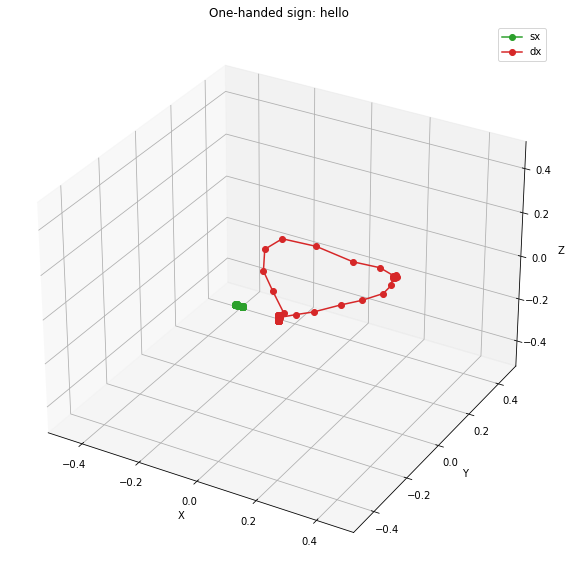

In [20]:
import matplotlib.pyplot as plt
import numpy as np

fig = plt.figure(figsize=(12,10))
ax = fig.add_subplot(projection='3d')
sx_xs = one_data[:,0][:]
sx_ys = one_data[:,1][:]
sx_zs = one_data[:,2][:]
dx_xs = one_data[:,11][:]
dx_ys = one_data[:,12][:]
dx_zs = one_data[:,13][:]

'''
min_sx = np.min( [np.min(sx_xs), np.min(sx_ys), np.min(sx_zs)] )
min_dx = np.min( [np.min(dx_xs), np.min(dx_ys), np.min(dx_zs)] )
max_sx = np.max( [np.max(sx_xs), np.max(sx_ys), np.max(sx_zs)] )
max_dx = np.max( [np.max(dx_xs), np.max(dx_ys), np.max(dx_zs)] )
final_min = np.min([min_sx, min_dx])
final_max = np.max([max_sx, max_dx])

ax.set_xlim(final_min, final_max)
ax.set_ylim(final_min, final_max)
ax.set_zlim(final_min, final_max)
'''

ax.set_xlim(-0.5, 0.5)
ax.set_ylim(-0.5, 0.5)
ax.set_zlim(-0.5, 0.5)

ax.plot(sx_xs, sx_ys, sx_zs, marker='o', label='sx', color='tab:green', alpha=1)
ax.plot(dx_xs, dx_ys, dx_zs, marker='o', label='dx', color='tab:red', alpha=1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
plt.legend()
plt.title('One-handed sign: hello')
'''plt.tick_params(
    axis='both',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off'''

In [7]:
sx_ys

array([0.113741, 0.114411, 0.114679, 0.115125, 0.115438, 0.116063,
       0.115393, 0.114679, 0.114813, 0.113607, 0.109812, 0.109901,
       0.110303, 0.109544, 0.110259, 0.111553, 0.112357, 0.113429,
       0.114009, 0.115036, 0.115215, 0.114232, 0.114456, 0.115125,
       0.113831, 0.113295, 0.114143, 0.114009, 0.114143, 0.115081,
       0.115929, 0.116197, 0.116688, 0.117447, 0.11776 , 0.11709 ,
       0.116509, 0.116509, 0.115304, 0.1145  , 0.114947, 0.114456,
       0.114322, 0.114813, 0.115438, 0.115572, 0.115929, 0.116643,
       0.116554, 0.116599, 0.116554, 0.116733, 0.116063, 0.115483,
       0.115884, 0.11459 , 0.113295, 0.114009, 0.113697, 0.112714,
       0.11325 , 0.113563])

In [74]:
sx_xs = one_data[:,0]
sx_ys = one_data[:,1]
sx_zs = one_data[:,2]
dx_xs = one_data[:,11]
dx_ys = one_data[:,12]
dx_zs = one_data[:,13]

In [75]:
sx_xs

array([-0.103487, -0.105898, -0.108979, -0.108443, -0.107148, -0.108532,
       -0.108889, -0.108175, -0.107639, -0.10813 , -0.106657, -0.105362,
       -0.105407, -0.105853, -0.104692, -0.103621, -0.105451, -0.107371,
       -0.1063  , -0.107371, -0.108934, -0.108979, -0.108443, -0.109336,
       -0.107595, -0.107595, -0.110274, -0.085716, -0.083394, -0.096343,
       -0.0967  , -0.083662, -0.0967  , -0.102192, -0.083394, -0.08402 ,
       -0.082993, -0.086252, -0.084466, -0.084287, -0.083662, -0.084064,
       -0.084779, -0.083618, -0.083707, -0.085314, -0.084421, -0.083796,
       -0.085404, -0.084913, -0.084243, -0.084734, -0.085404, -0.084511,
       -0.08393 , -0.084823, -0.084689, -0.083439, -0.084064, -0.084466,
       -0.083662, -0.083439])

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
for i in range(len(one_data)):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(projection='3d')
    sx_xs = one_data[:,0][i]
    sx_ys = one_data[:,1][i]
    sx_zs = one_data[:,2][i]
    dx_xs = one_data[:,11][i]
    dx_ys = one_data[:,12][i]
    dx_zs = one_data[:,13][i]

    ax.scatter(sx_xs, sx_ys, sx_zs, marker='o', label='sx', color='tab:green', alpha=1)
    ax.scatter(dx_xs, dx_ys, dx_zs, marker='o', label='sx', color='tab:red', alpha=1)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    '''ax.set_xlim(np.min( np.min(sx_xs), np.min(dx_xs) ), np.max( np.max(sx_xs), np.max(dx_xs) ))
    ax.set_ylim(np.min( np.min(sx_ys), np.min(dx_ys) ), np.max( np.max(sx_ys), np.max(dx_ys) ))
    ax.set_zlim(np.min( np.min(sx_zs), np.min(dx_zs) ), np.max( np.max(sx_zs), np.max(dx_zs) ))'''
    
    ax.set_xlim(-0.5,0.5)
    ax.set_ylim(-0.5, 0.5)
    ax.set_zlim(-0.5, 0.5)
    

    plt.title('One-handed sign: hello')
    if i < 10:
        plt.savefig(f"hello_gif/00{i}_hello.png", format='png', dpi=300)
    else:
        plt.savefig(f"hello_gif/0{i}_hello.png", format='png', dpi=300)

In [92]:
import cv2
import numpy as np
import glob

imgs = []
for filename in glob.glob('hello_gif/*.png'):
    imgs.append(filename)

sorted(imgs)

['hello_gif/000_hello.png',
 'hello_gif/001_hello.png',
 'hello_gif/002_hello.png',
 'hello_gif/003_hello.png',
 'hello_gif/004_hello.png',
 'hello_gif/005_hello.png',
 'hello_gif/006_hello.png',
 'hello_gif/007_hello.png',
 'hello_gif/008_hello.png',
 'hello_gif/009_hello.png',
 'hello_gif/010_hello.png',
 'hello_gif/011_hello.png',
 'hello_gif/012_hello.png',
 'hello_gif/013_hello.png',
 'hello_gif/014_hello.png',
 'hello_gif/015_hello.png',
 'hello_gif/016_hello.png',
 'hello_gif/017_hello.png',
 'hello_gif/018_hello.png',
 'hello_gif/019_hello.png',
 'hello_gif/020_hello.png',
 'hello_gif/021_hello.png',
 'hello_gif/022_hello.png',
 'hello_gif/023_hello.png',
 'hello_gif/024_hello.png',
 'hello_gif/025_hello.png',
 'hello_gif/026_hello.png',
 'hello_gif/027_hello.png',
 'hello_gif/028_hello.png',
 'hello_gif/029_hello.png',
 'hello_gif/030_hello.png',
 'hello_gif/031_hello.png',
 'hello_gif/032_hello.png',
 'hello_gif/033_hello.png',
 'hello_gif/034_hello.png',
 'hello_gif/035_hell

In [94]:
import cv2
import numpy as np
import glob

img_array = []
imgs = []
for filename in glob.glob('hello_gif/*.png'):
    imgs.append(filename)
for filename in sorted(imgs):
    img = cv2.imread(filename)
    height, width, layers = img.shape
    size = (width,height)
    img_array.append(img)


out = cv2.VideoWriter('project.avi',cv2.VideoWriter_fourcc(*'DIVX'), 5, size)
 
for i in range(len(img_array)):
    out.write(img_array[i])
out.release()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
for i in range(len(one_data)):
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_subplot(projection='3d')
    sx_xs = one_data[:,0][:i]
    sx_ys = one_data[:,1][:i]
    sx_zs = one_data[:,2][:i]
    dx_xs = one_data[:,11][:i]
    dx_ys = one_data[:,12][:i]
    dx_zs = one_data[:,13][:i]

    ax.plot(sx_xs, sx_ys, sx_zs, marker='o', label='sx', color='tab:green', alpha=1)
    ax.plot(dx_xs, dx_ys, dx_zs, marker='o', label='sx', color='tab:red', alpha=1)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    '''ax.set_xlim(np.min( np.min(sx_xs), np.min(dx_xs) ), np.max( np.max(sx_xs), np.max(dx_xs) ))
    ax.set_ylim(np.min( np.min(sx_ys), np.min(dx_ys) ), np.max( np.max(sx_ys), np.max(dx_ys) ))
    ax.set_zlim(np.min( np.min(sx_zs), np.min(dx_zs) ), np.max( np.max(sx_zs), np.max(dx_zs) ))'''
    
    ax.set_xlim(-0.5,0.5)
    ax.set_ylim(-0.5, 0.5)
    ax.set_zlim(-0.5, 0.5)
    

    plt.title('One-handed sign: hello')
    if i < 10:
        plt.savefig(f"hello_line_gif/00{i}_hello.png", format='png', dpi=300)
    else:
        plt.savefig(f"hello_line_gif/0{i}_hello.png", format='png', dpi=300)

In [96]:
import cv2
import numpy as np
import glob

img_array = []
imgs = []
for filename in glob.glob('hello_line_gif/*.png'):
    imgs.append(filename)
for filename in sorted(imgs):
    img = cv2.imread(filename)
    height, width, layers = img.shape
    size = (width,height)
    img_array.append(img)


out = cv2.VideoWriter('project.mp4',cv2.VideoWriter_fourcc(*'mp4v'), 10, size)
 
for i in range(len(img_array)):
    out.write(img_array[i])
out.release()

OpenCV: FFMPEG: tag 0x5634504d/'MP4V' is not supported with codec id 12 and format 'mp4 / MP4 (MPEG-4 Part 14)'
OpenCV: FFMPEG: fallback to use tag 0x7634706d/'mp4v'


In [5]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import utils.rotation as urotation

def plot_frames(data:np.ndarray, lim:float, sign:str, folder:str, dx_plot_dict:dict, sx_plot_dict:dict, plot_axis:bool=True,):
    """
    Plot motion frames of the input data.
    Input data contains x, y, z, roll, pitch, and yaw of left and right hands.

    Args:
        data (np.ndarray): input data in array format. Shape [time_series_length, num_predictors]
        lim (float): set limit bounds to x, y, and z
        sign (str): label of the passed sign
        folder (str): folder in which save frames
        dx_plot_dict (dict): **kwargs concerning right hand (x,y,z) plot
        sx_plot_dict (dict): **kwargs concerning left hand (x,y,z) plot
        plot_axis (bool, optional): whether to show or not axis. Defaults to True.
    """
    n_features_per_hand = 11
    sx_stack = data[:,3:6]
    dx_stack = data[:,3+n_features_per_hand:6+n_features_per_hand]

    v_dirs = np.array([[1, 0, 0], # versors' direction
                [0, 1, 0],
                [0, 0, 1]])

    origin = np.array([0,0,0]) # origin point, same origin point for x,y and, z
    
    for i in range(data.shape[0]): # data.shape = [ts_length, num_predictors]
    
        fig = plt.figure(figsize=(12,10))
        ax = fig.add_subplot(projection='3d')
        
        # pick x, y, z of the left hand and plot the movements
        sx_xs = data[:,0][:i + 1]
        sx_ys = data[:,1][:i + 1]
        sx_zs = data[:,2][:i + 1]
        sx_origin = np.array([sx_xs[-1], sx_ys[-1], sx_zs[-1]])
        ax.plot(sx_xs, sx_ys, sx_zs, **sx_plot_dict)#marker='o', label='sx', color='tab:blue', alpha=1, fillstyle=None)
        
        # pick x, y, z of the right hand and plot the movements
        dx_xs = data[:,11][:i + 1]
        dx_ys = data[:,12][:i + 1]
        dx_zs = data[:,13][:i + 1]
        dx_origin = np.array([dx_xs[-1], dx_ys[-1], dx_zs[-1]])
        ax.plot(dx_xs, dx_ys, dx_zs, **dx_plot_dict)#marker='o', label='dx', color='tab:orange', alpha=1, fillstyle=None)
        
        # pick pitch, roll, yaw of the left hand and plot the orientation
        sx_roll_angle = - sx_stack[i,0] # add minus to fix mirroring
        sx_pitch_angle = sx_stack[i,1] - 0.5 # offset due to normalization
        sx_yaw_angle = sx_stack[i,2] - 0.5 # offset due to normalization
        # compute the overall rotation matrix for the left hand
        sx_R = urotation.rotation_matrix(sx_roll_angle, sx_pitch_angle, sx_yaw_angle)
        
        # pick pitch, roll, yaw of the left hand and plot the orientation
        dx_roll_angle = dx_stack[i,0]
        dx_pitch_angle = dx_stack[i,1] - 0.5 # offset due to normalization
        dx_yaw_angle = dx_stack[i,2] - 0.5 # offset due to normalization
        # compute the overall rotation matrix for the right hand
        dx_R = urotation.rotation_matrix(dx_roll_angle, dx_pitch_angle, dx_yaw_angle)
        
        U, V, W = zip(*v_dirs)
        # perform the rotation of the versors for both left and right hand
        sx_UVW = sx_R@np.array([U, V, W])
        dx_UVW = dx_R@np.array([U, V, W])

        # sx_x
        ax.quiver(*sx_origin, *sx_UVW[:,0], color=['r'], length=.1, normalize=True, label='pitch axis', arrow_length_ratio=0.1, linewidths=1.5)
        # sx_y
        ax.quiver(*sx_origin, *sx_UVW[:,1], color=['g'], length=.1, normalize=True, label='roll axis', arrow_length_ratio=0.1, linewidths=1.5)
        # sx_z
        ax.quiver(*sx_origin, *sx_UVW[:,2], color=['b'], length=.1, normalize=True, label='yaw axis', arrow_length_ratio=0.1, linewidths=1.5)

        # dx_x
        ax.quiver(*dx_origin, *dx_UVW[:,0], color=['r'], length=.1, normalize=True, label='_dx_x: roll axis', arrow_length_ratio=0.1, linewidths=1.5)
        # dx_y
        ax.quiver(*dx_origin, *dx_UVW[:,1], color=['g'], length=.1, normalize=True, label='_dx_y: pitch axis', arrow_length_ratio=0.1, linewidths=1.5)
        # dx_z
        ax.quiver(*dx_origin, *dx_UVW[:,2], color=['b'], length=.1, normalize=True, label='_dx_z: yaw axis', arrow_length_ratio=0.1, linewidths=1.5)
        
        # set the limit of the axis
        ax.set_xlim([-lim, lim])
        ax.set_ylim([-lim, lim])
        ax.set_zlim([-lim, lim])
        
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')
        
        #plt.title(f"Sign: '{sign}'")
        plt.tight_layout()
        
        #plt.legend()
        if not plot_axis:
            plt.axis('off')
        
        if i < 10:
            plt.savefig(f"{folder}/{sign.lower()}_00{i}.png", format='png', dpi=300)
        elif (i >= 10 and i < 100):
            plt.savefig(f"{folder}/{sign.lower()}_0{i}.png", format='png', dpi=300)
        else:
            plt.savefig(f"{folder}/{sign.lower()}_{i}.png", format='png', dpi=300)

        plt.show()

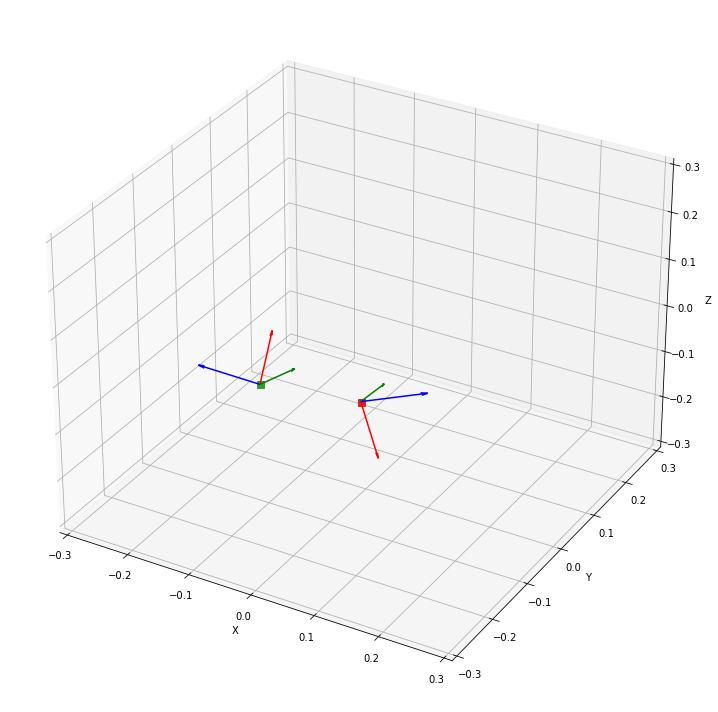

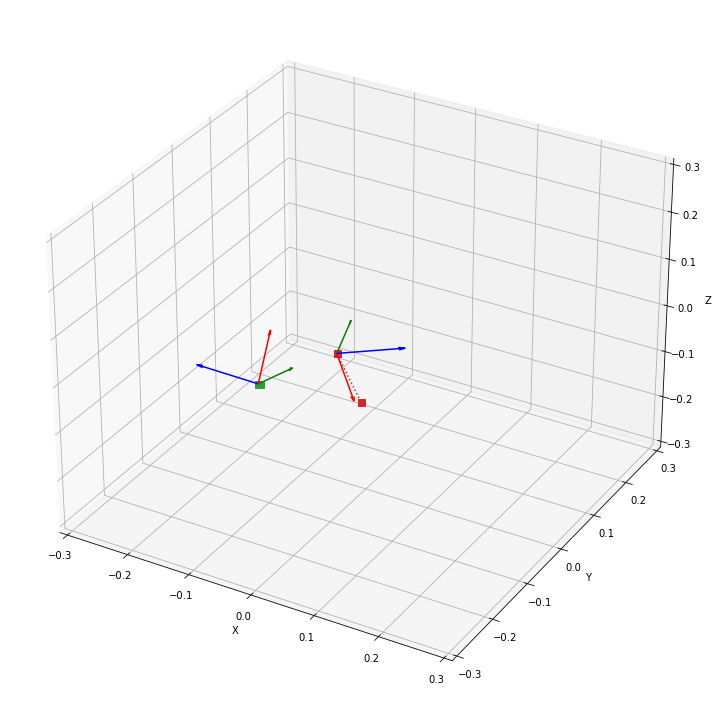

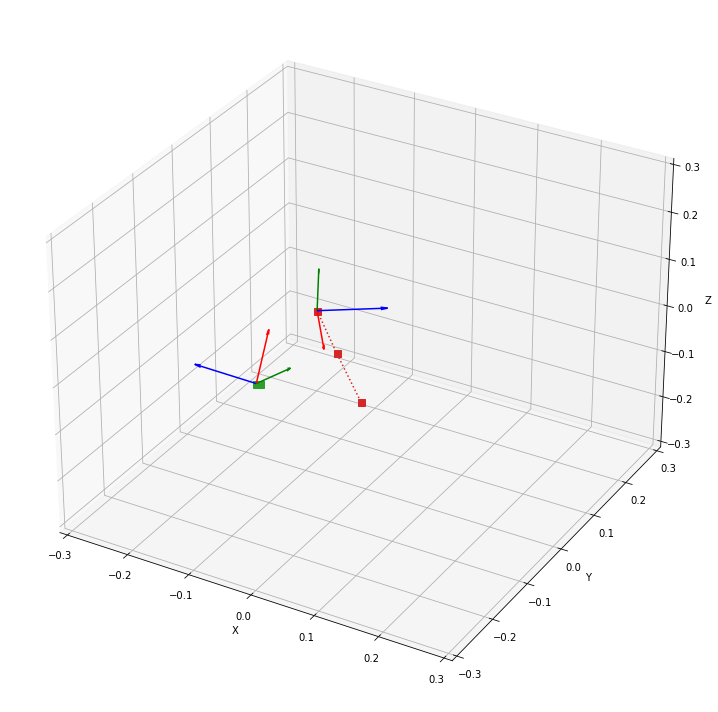

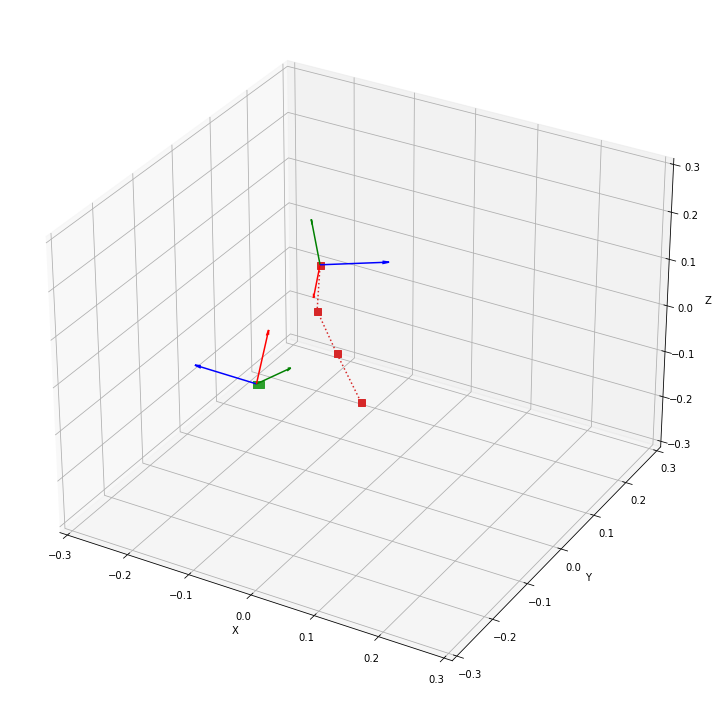

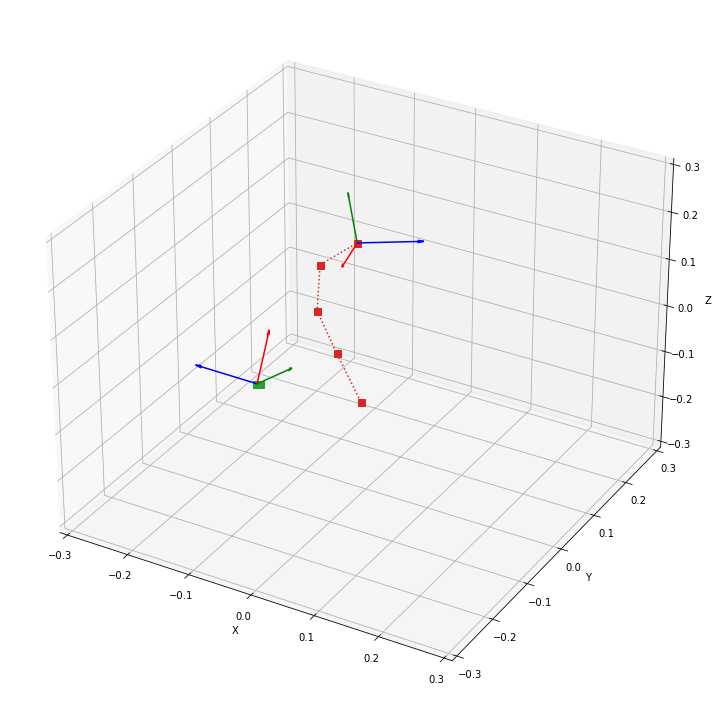

...

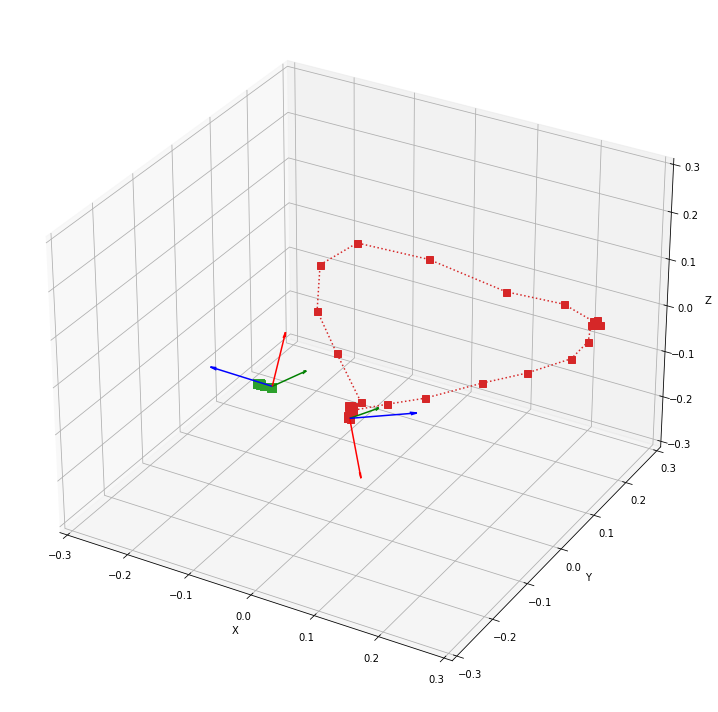

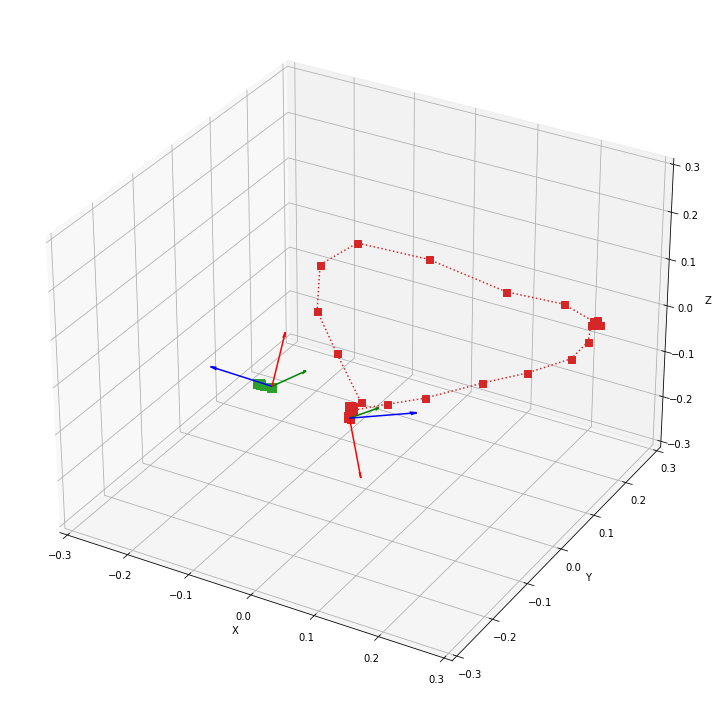

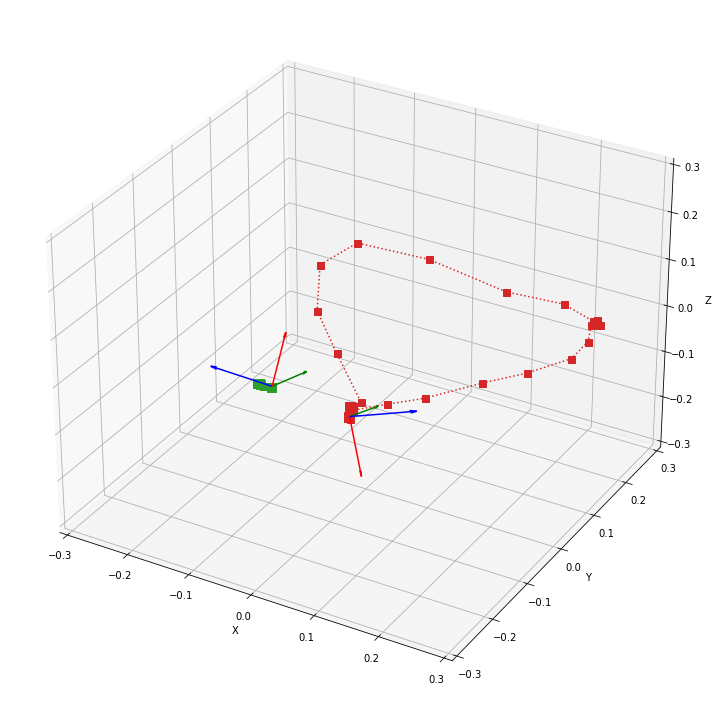

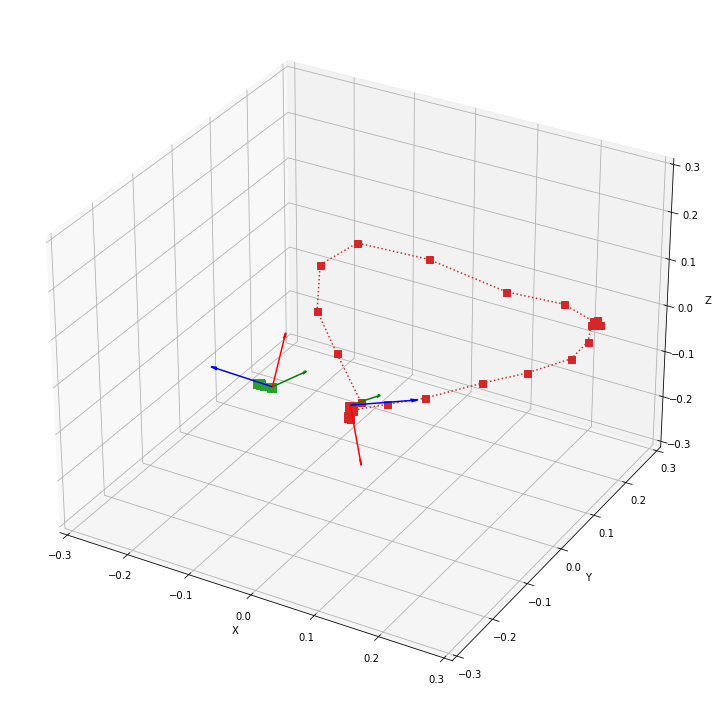

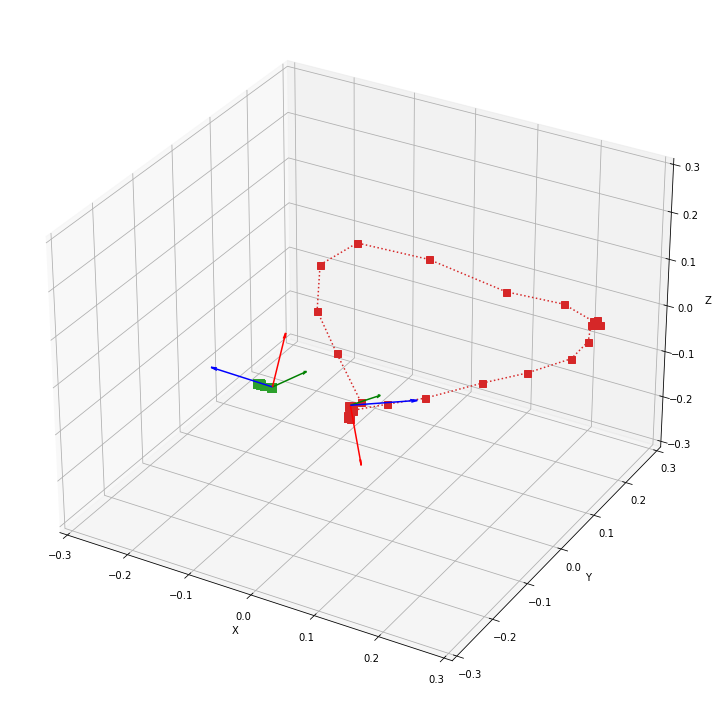

In [7]:
sx_plot_dict = {'marker':'s', 'markersize':7, 'color':'tab:green', 'alpha':1, 'linestyle':'dotted', 'label':'sx'}
dx_plot_dict = {'marker':'s', 'markersize':7, 'color':'tab:red', 'alpha':1, 'linestyle':'dotted', 'label':'dx'}

plot_frames(one_data, .3, 'hello', 'test/test_gif/', dx_plot_dict, sx_plot_dict )

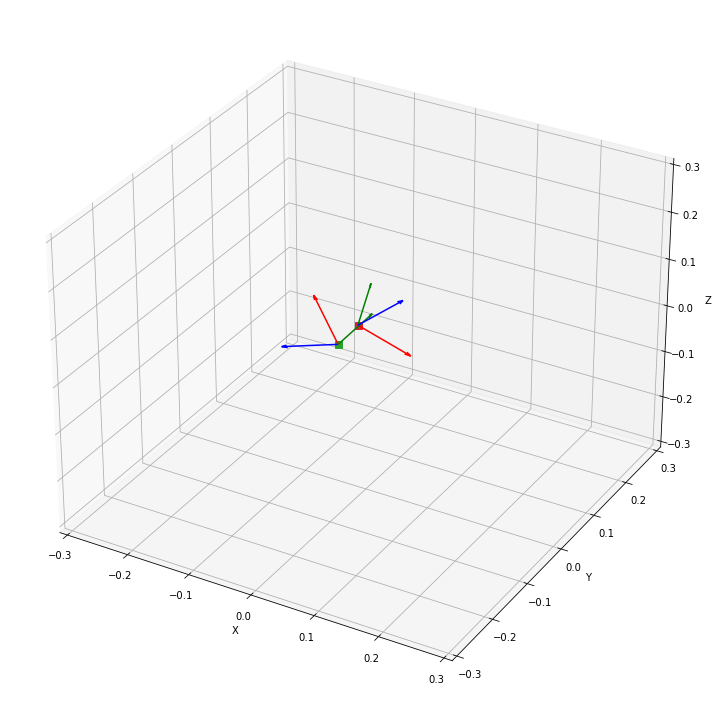

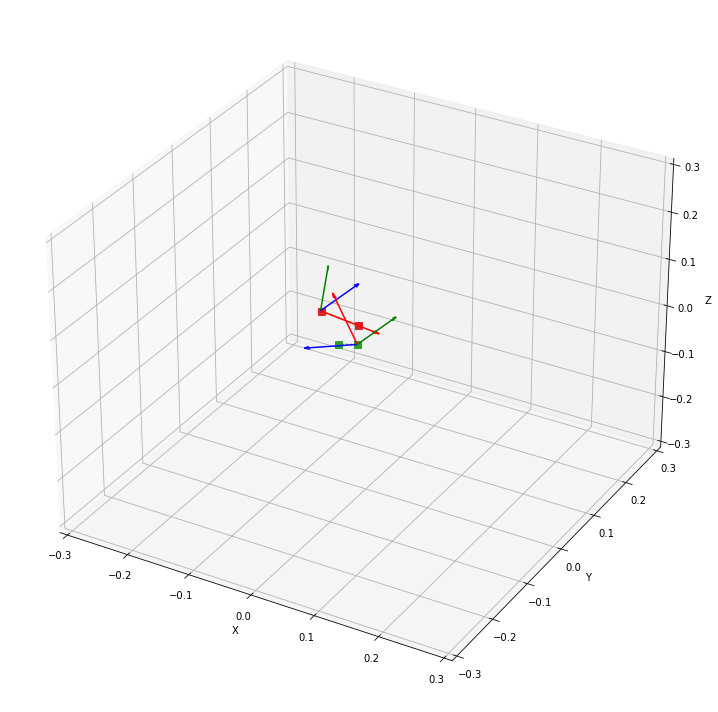

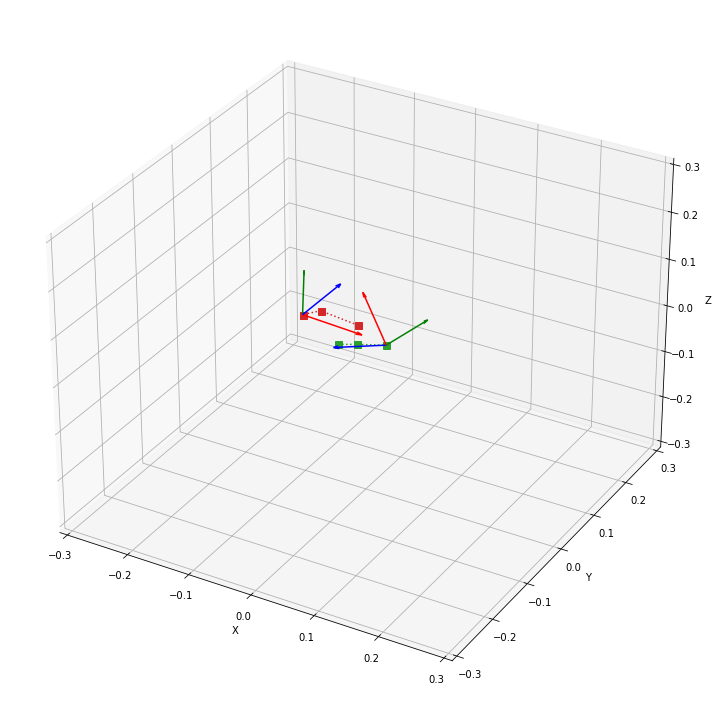

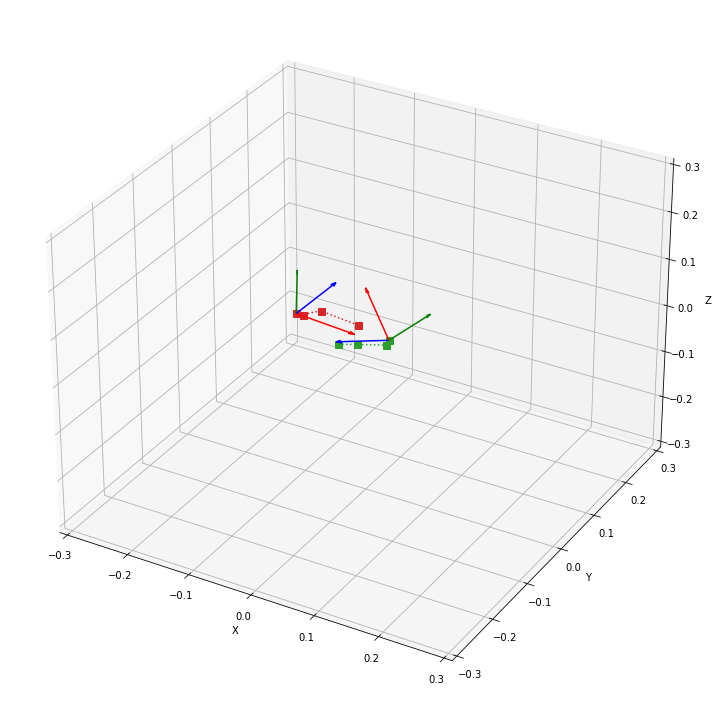

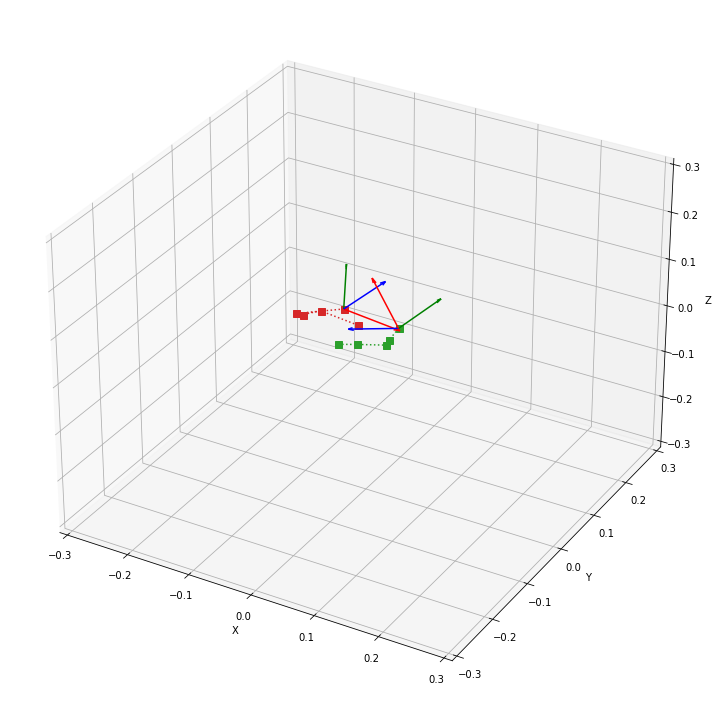

...

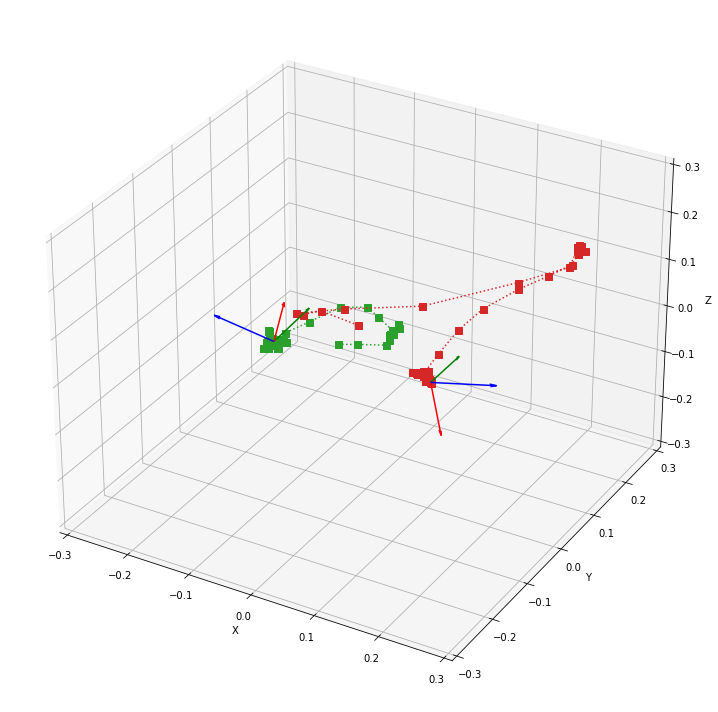

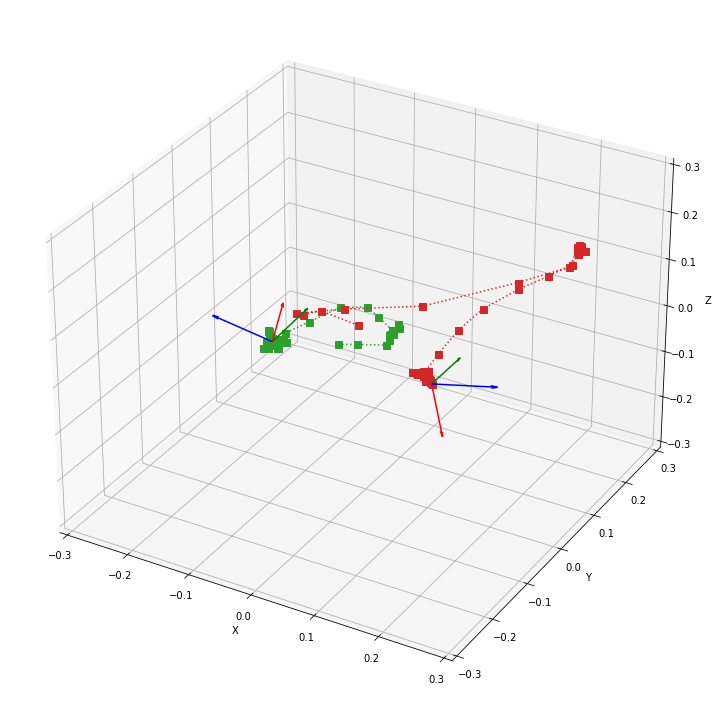

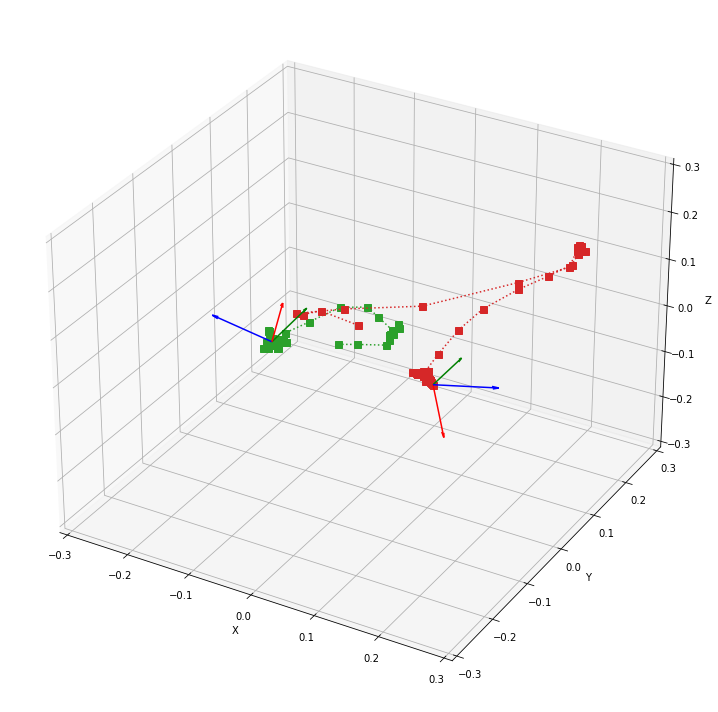

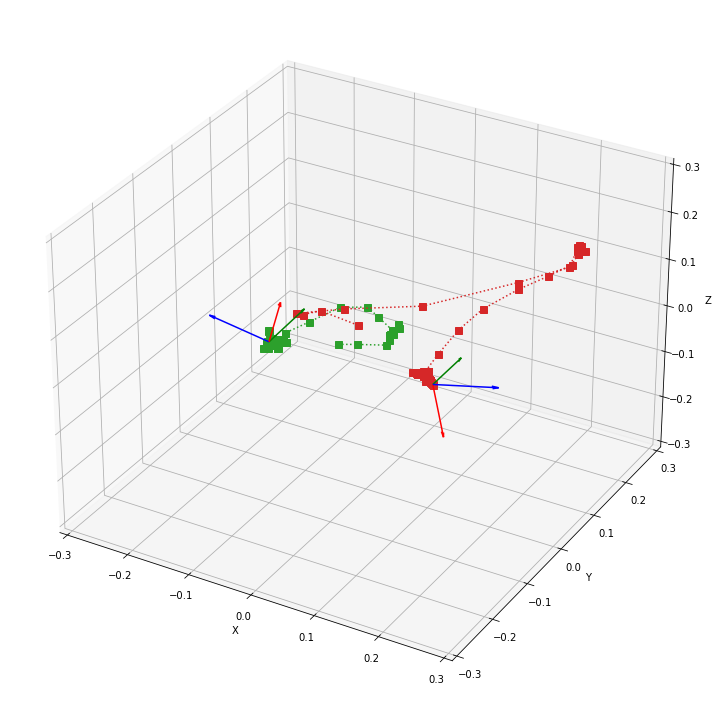

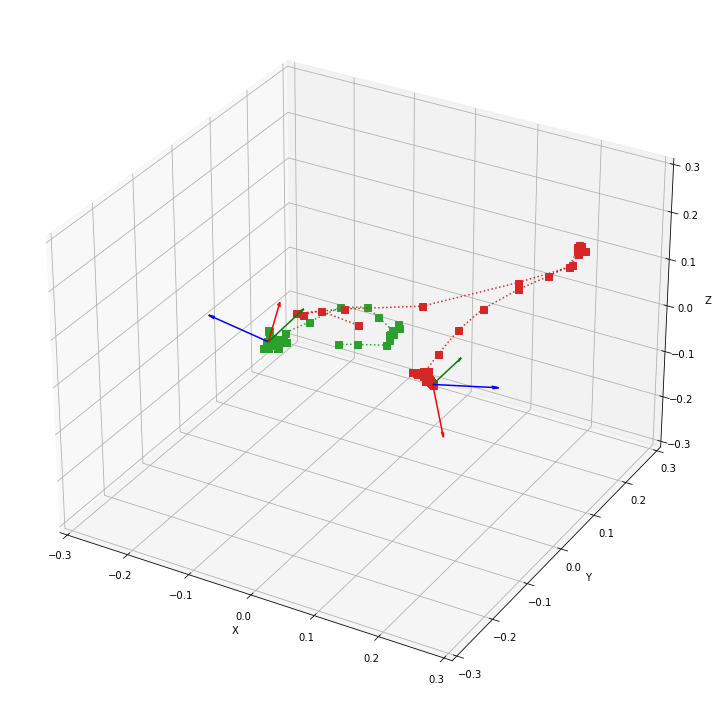

In [8]:
plot_frames(two_data, .3, 'God', 'test/test_gif/', dx_plot_dict, sx_plot_dict )

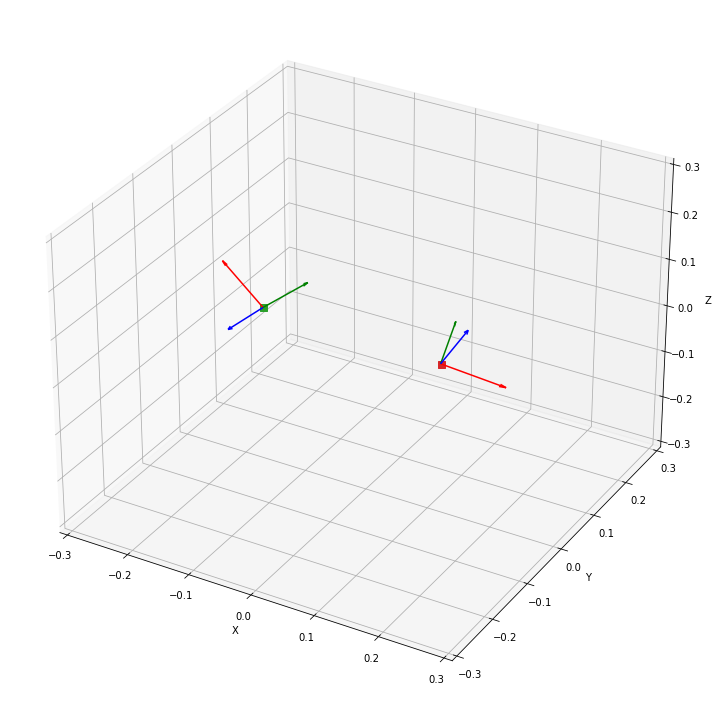

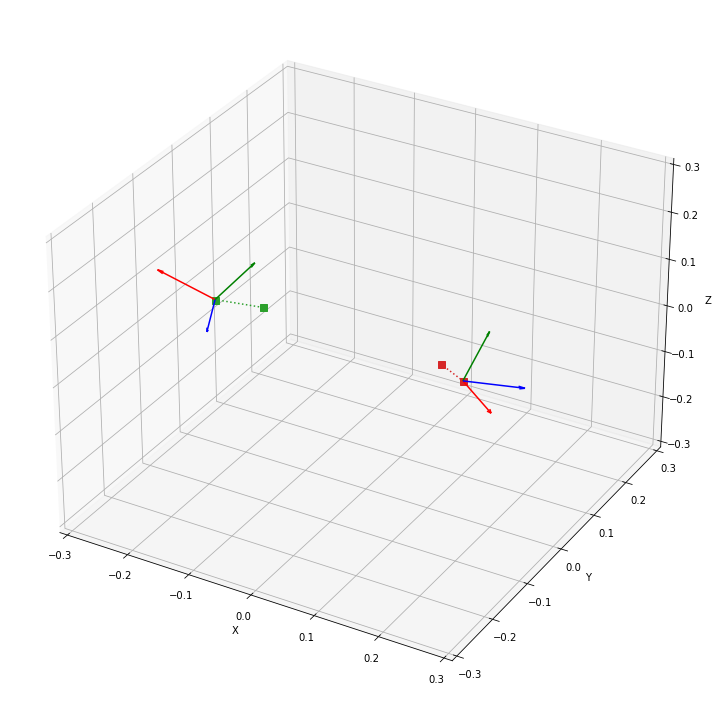

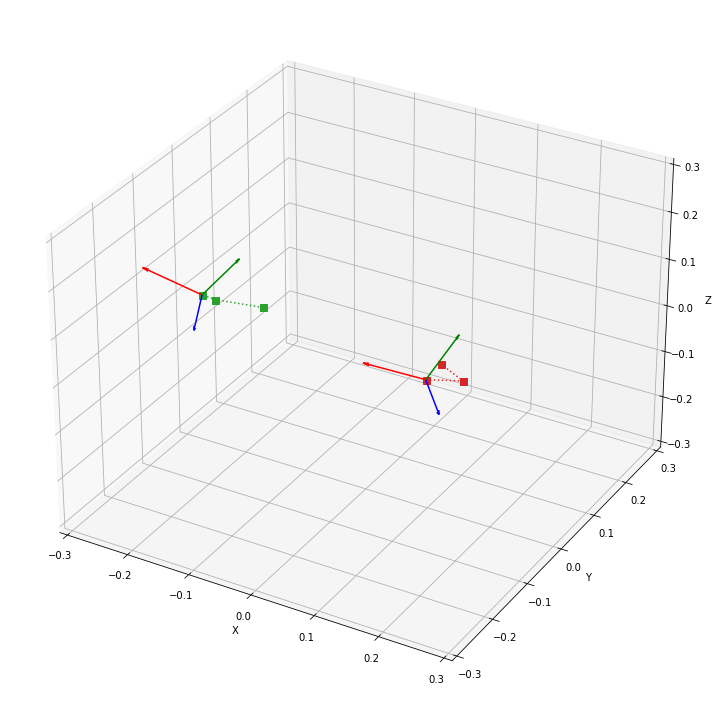

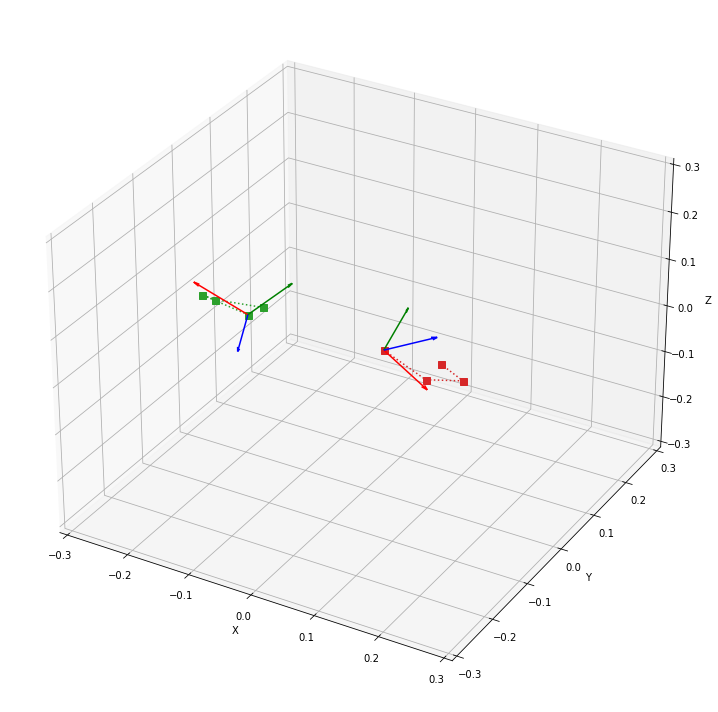

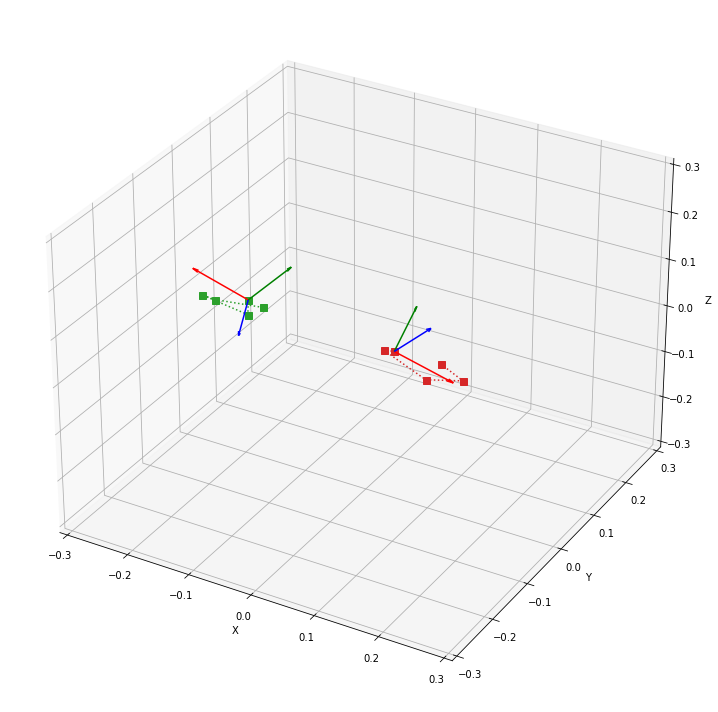

...

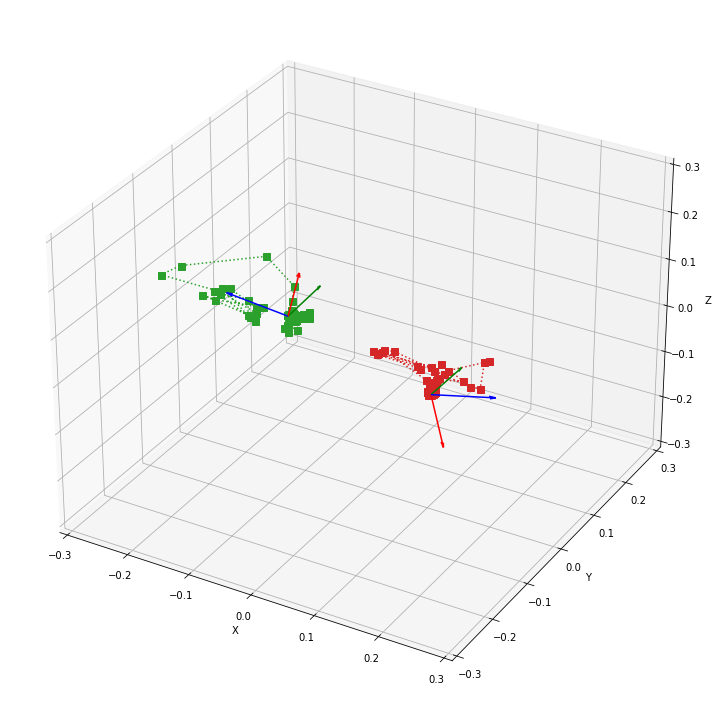

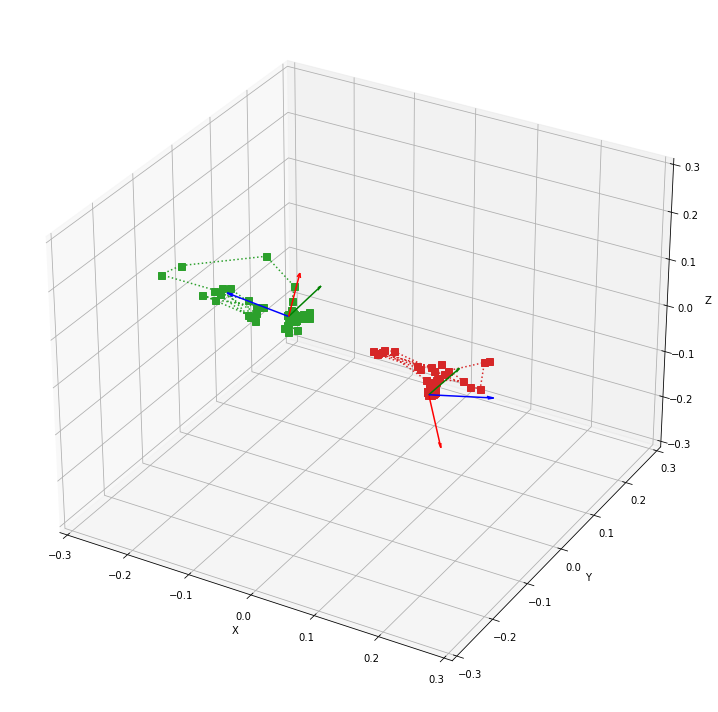

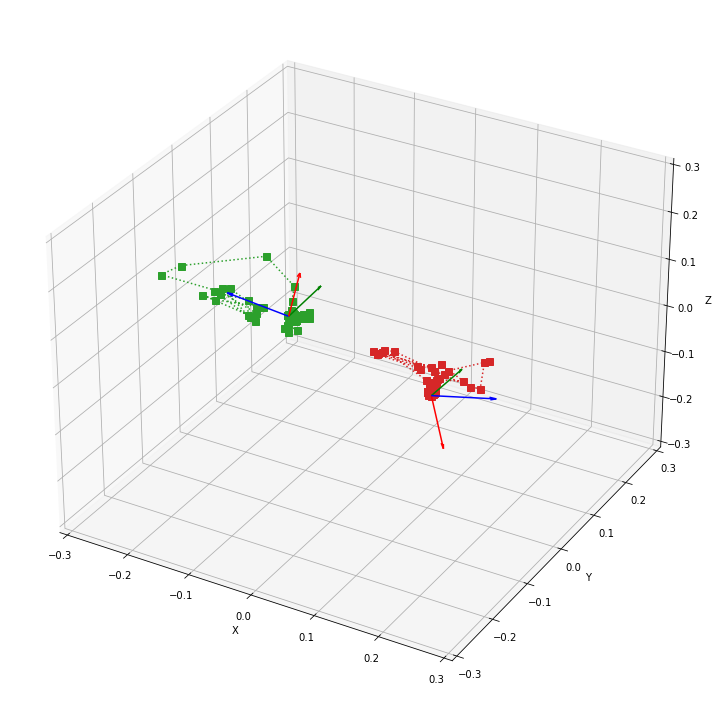

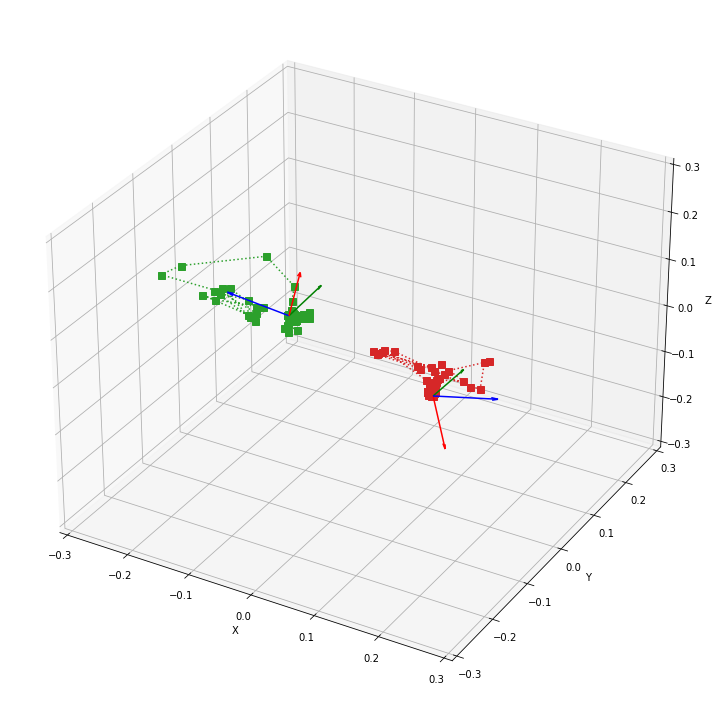

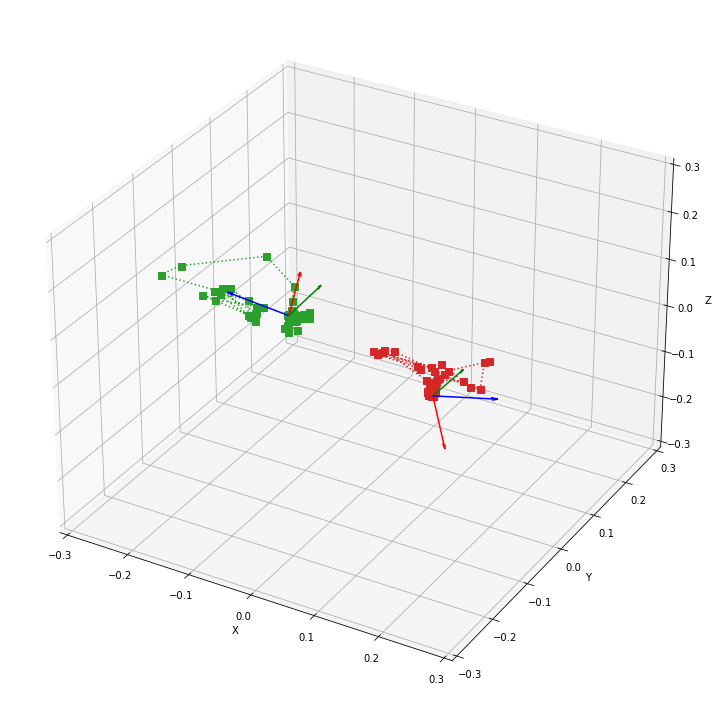

In [9]:
plot_frames(spec_two_data, .3, 'where', 'test/test_gif/', dx_plot_dict, sx_plot_dict )